# Urban3D Navigator — Bolzano EDA

Exploratory Data Analysis notebook for the Bolzano, Italy dataset.
Covers all five sprint deliverables from issue #10:

| Section | Topic |
|---------|-------|
| 1 | AOI definition + OSM fetch |
| 2 | Height processing walkthrough |
| 3 | Road network classification |
| 4 | PyDeck inline 3-D preview |
| 5 | Quality metrics dashboard |

**Run from:** `pipeline/notebooks/`  
**Data path:** `../data/processed/bolzano_italy/`

In [1]:
# ── Shared imports ────────────────────────────────────────────────────
import sys, json
from pathlib import Path

import geopandas as gpd
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.ticker as mticker
import pydeck as pdk

# Make pipeline package importable
sys.path.insert(0, str(Path('..').resolve()))

DATA_DIR = Path('../data/processed/bolzano_italy')
BUILDINGS_PATH = DATA_DIR / 'buildings.geojson'
ROADS_PATH     = DATA_DIR / 'roads.geojson'
METADATA_PATH  = DATA_DIR / 'metadata.json'

plt.rcParams.update({'figure.dpi': 120, 'axes.spines.top': False, 'axes.spines.right': False})
print('Imports OK')

Imports OK


---
## Section 1 — AOI Definition + OSM Fetch

Show the bounding box used for data extraction, load the processed
buildings GeoDataFrame, and inspect its raw structure.

In [2]:
# Load pipeline config to show BBOX
from config import BBOX, DEFAULT_HEIGHT_M, FLOOR_HEIGHT_M

lat_max, lat_min, lon_max, lon_min = BBOX
print(f'AOI bounding box')
print(f'  North : {lat_max}°')
print(f'  South : {lat_min}°')
print(f'  East  : {lon_max}°')
print(f'  West  : {lon_min}°')
print(f'  Width : {abs(lon_max - lon_min)*111:.1f} km')
print(f'  Height: {abs(lat_max - lat_min)*111:.1f} km')
print(f'Default building height : {DEFAULT_HEIGHT_M} m')
print(f'Assumed floor height    : {FLOOR_HEIGHT_M} m')

AOI bounding box
  North : 46.515°
  South : 46.465°
  East  : 11.385°
  West  : 11.315°
  Width : 7.8 km
  Height: 5.5 km
Default building height : 9.0 m
Assumed floor height    : 3.0 m


In [3]:
# Load processed buildings GeoDataFrame
gdf_buildings = gpd.read_file(BUILDINGS_PATH)
print(f'Buildings: {len(gdf_buildings):,} features')
print(f'CRS      : {gdf_buildings.crs}')
gdf_buildings.head(3)

Buildings: 5,794 features
CRS      : EPSG:4326


,height,height_source,building_type,name,geometry
0,9.0,default,cathedral,Duomo di Bolzano - Bozner Dom,"POLYGON ((11.35448 46.49755, 11.35453 46.49756..."
1,9.0,default,yes,Bolzano Centro - Bozen Mitte,"POLYGON ((11.35685 46.49474, 11.35672 46.49440..."
2,18.0,levels,school,"Technologische Fachoberschule ""Max Valier"" Bozen","POLYGON ((11.32669 46.49417, 11.32673 46.49387..."


In [4]:
# Column overview
gdf_buildings.dtypes.to_frame('dtype').join(
    gdf_buildings.isnull().sum().to_frame('null_count')
).join(
    gdf_buildings.nunique().to_frame('unique_values')
)

,dtype,null_count,unique_values
height,float64,0,14
height_source,object,0,2
building_type,object,0,49
name,object,0,478
geometry,geometry,0,5794


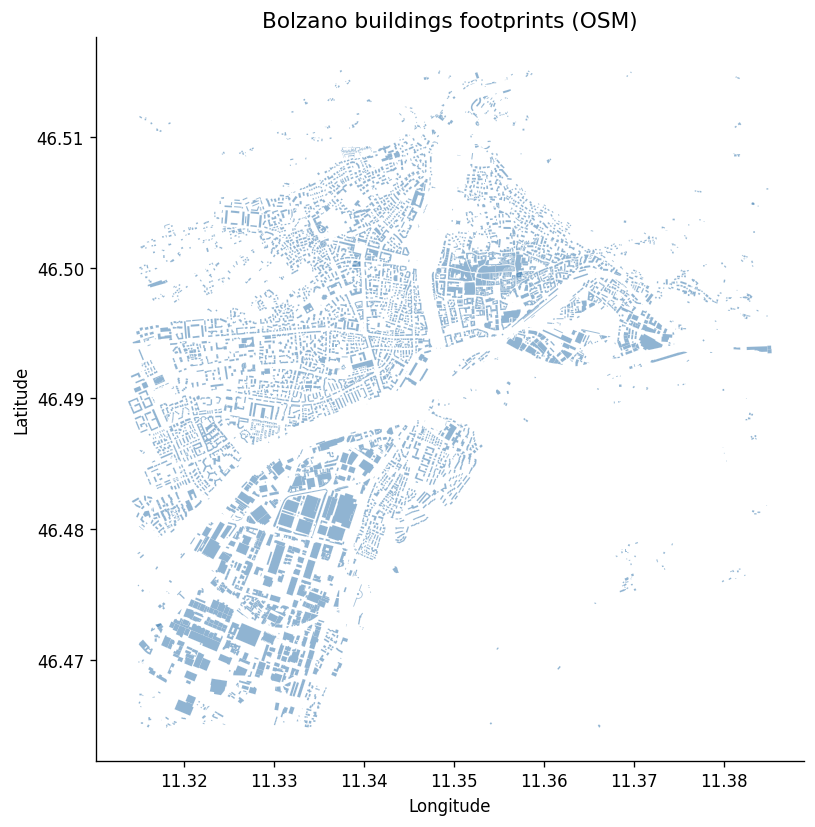

In [5]:
# Quick spatial plot of the AOI
fig, ax = plt.subplots(figsize=(8, 7))
gdf_buildings.plot(ax=ax, color='steelblue', edgecolor='white', linewidth=0.1, alpha=0.6)
ax.set_title('Bolzano buildings footprints (OSM)', fontsize=13)
ax.set_xlabel('Longitude'); ax.set_ylabel('Latitude')
plt.tight_layout()
plt.show()

---
## Section 2 — Height Processing Walkthrough

Show how building heights are derived (OSM tag → floor count → default)
and visualise the distribution with charts.

In [6]:
# Height source breakdown
source_counts = gdf_buildings['height_source'].value_counts()
print('Height source breakdown:')
print(source_counts.to_string())
print(f'\nKnown height (osm/levels): {source_counts.get("osm", 0) + source_counts.get("levels", 0):,} '
      f'({(source_counts.get("osm", 0) + source_counts.get("levels", 0)) / len(gdf_buildings) * 100:.1f}%)')

Height source breakdown:
height_source
default    5526
levels      268

Known height (osm/levels): 268 (4.6%)


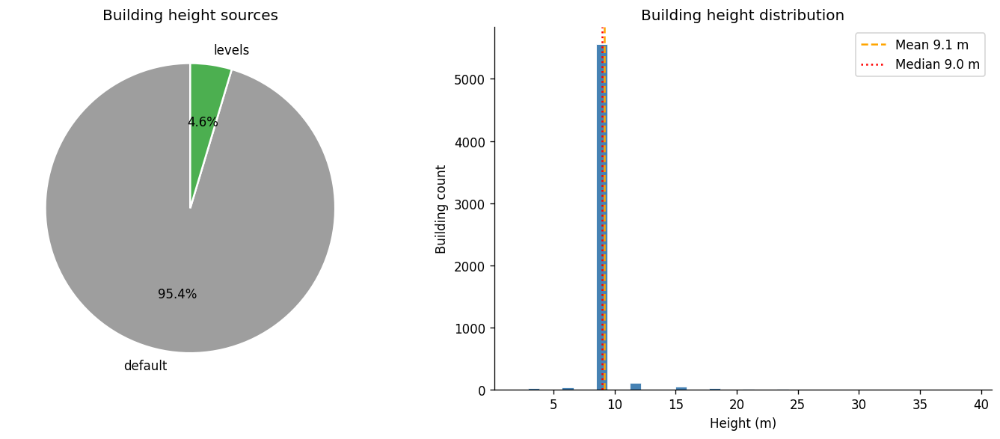

Height stats — min: 2.0 m  |  mean: 9.1 m  |  p95: 9.0 m  |  max: 39.0 m


In [7]:
fig, axes = plt.subplots(1, 2, figsize=(12, 5))

# --- Pie: height sources ---
colours = {'osm': '#2196F3', 'levels': '#4CAF50', 'default': '#9E9E9E', 'overture': '#FF9800'}
pie_colours = [colours.get(s, '#ccc') for s in source_counts.index]
axes[0].pie(
    source_counts.values, labels=source_counts.index,
    colors=pie_colours, autopct='%1.1f%%', startangle=90,
    wedgeprops={'edgecolor': 'white', 'linewidth': 1.5}
)
axes[0].set_title('Building height sources')

# --- Histogram: height distribution ---
h = gdf_buildings['height'].dropna()
axes[1].hist(h, bins=40, color='steelblue', edgecolor='white', linewidth=0.5)
axes[1].axvline(h.mean(), color='orange', linewidth=1.5, linestyle='--', label=f'Mean {h.mean():.1f} m')
axes[1].axvline(h.median(), color='red', linewidth=1.5, linestyle=':', label=f'Median {h.median():.1f} m')
axes[1].set_xlabel('Height (m)')
axes[1].set_ylabel('Building count')
axes[1].set_title('Building height distribution')
axes[1].legend()

plt.tight_layout()
plt.show()

print(f'Height stats — min: {h.min():.1f} m  |  mean: {h.mean():.1f} m  |  '
      f'p95: {h.quantile(0.95):.1f} m  |  max: {h.max():.1f} m')

/var/folders/p8/xx7p9j4s5dqgv5xtg97tqrwr0000gn/T/ipykernel_5120/3389635594.py:5: MatplotlibDeprecationWarning: The 'labels' parameter of boxplot() has been renamed 'tick_labels' since Matplotlib 3.9; support for the old name will be dropped in 3.11.
  bp = ax.boxplot(groups, labels=source_counts.index, patch_artist=True, notch=False)


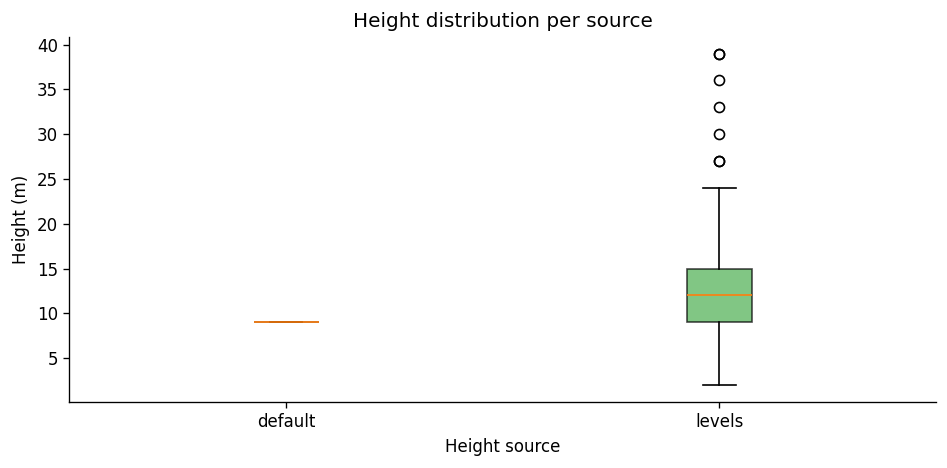

In [8]:
# Height by source — boxplot comparison
fig, ax = plt.subplots(figsize=(8, 4))
groups = [gdf_buildings[gdf_buildings['height_source'] == s]['height'].dropna().values
          for s in source_counts.index]
bp = ax.boxplot(groups, labels=source_counts.index, patch_artist=True, notch=False)
for patch, src in zip(bp['boxes'], source_counts.index):
    patch.set_facecolor(colours.get(src, '#ccc'))
    patch.set_alpha(0.7)
ax.set_xlabel('Height source')
ax.set_ylabel('Height (m)')
ax.set_title('Height distribution per source')
plt.tight_layout()
plt.show()

---
## Section 3 — Road Network Fetch + Classification

Load the processed road GeoDataFrame and verify class distribution.

In [9]:
gdf_roads = gpd.read_file(ROADS_PATH)
print(f'Roads: {len(gdf_roads):,} features')
print(f'CRS  : {gdf_roads.crs}')
gdf_roads.head(3)

Roads: 14,256 features
CRS  : EPSG:4326


,highway,road_class,name,line_width,geometry
0,[residential],minor,[Via Brennero - Brennerstraße],2,"LINESTRING (11.36107 46.50026, 11.36112 46.500..."
1,[residential],minor,[Piazza Dogana - Zollstangenplatz],2,"LINESTRING (11.36107 46.50026, 11.36104 46.500..."
2,[tertiary],minor,[Via Renon - Rittner Straße],2,"LINESTRING (11.36391 46.50001, 11.36362 46.49977)"


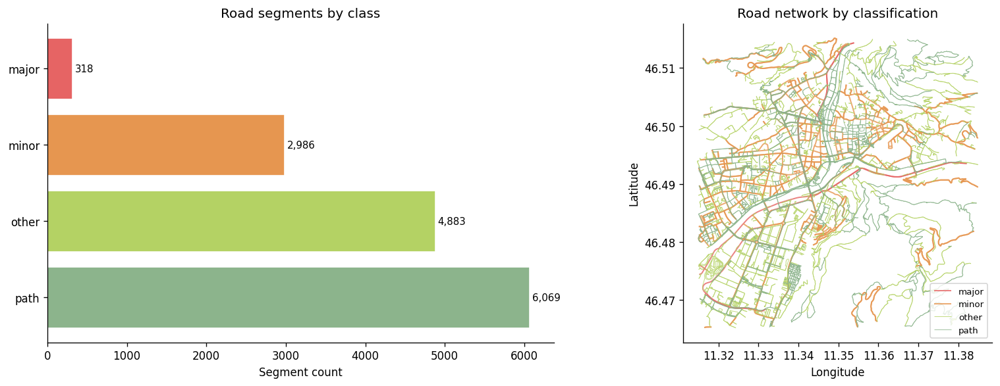

In [10]:
road_colours = {
    'major': '#E66464', 'minor': '#E69650',
    'other': '#B4D264', 'path':  '#8CB48C',
}

road_counts = gdf_roads['road_class'].value_counts()

fig, axes = plt.subplots(1, 2, figsize=(14, 5))

# Bar chart: road class counts
bar_colours = [road_colours.get(c, '#ccc') for c in road_counts.index]
axes[0].barh(road_counts.index, road_counts.values, color=bar_colours, edgecolor='white')
axes[0].set_xlabel('Segment count')
axes[0].set_title('Road segments by class')
for i, v in enumerate(road_counts.values):
    axes[0].text(v + 30, i, f'{v:,}', va='center', fontsize=9)

# Spatial plot: colour by road class
for cls, colour in road_colours.items():
    subset = gdf_roads[gdf_roads['road_class'] == cls]
    if not subset.empty:
        subset.plot(ax=axes[1], color=colour,
                    linewidth=0.6 if cls in ('path', 'other') else 1.2,
                    label=cls, alpha=0.8)
axes[1].set_title('Road network by classification')
axes[1].legend(fontsize=8, loc='lower right')
axes[1].set_xlabel('Longitude'); axes[1].set_ylabel('Latitude')

plt.tight_layout()
plt.show()


In [11]:
# Road width stats per class
gdf_roads.groupby('road_class')['line_width'].agg(['mean', 'min', 'max']).round(2).sort_values('mean', ascending=False)

,mean,min,max
road_class,,,
major,3.0,3,3
minor,2.0,2,2
other,1.0,1,1
path,1.0,1,1


---
## Section 4 — PyDeck Inline 3-D Visualisation

Render the buildings and roads as interactive 3-D layers directly in the notebook.

In [12]:
# Build the colour lookup pydeck needs (RGB as list)
TYPE_COLORS = {
    'apartments': [255, 160,  64], 'residential': [255, 160,  64],
    'house':      [255, 160,  64], 'detached':    [255, 160,  64],
    'commercial': [255, 107,  30], 'retail':       [255, 107,  30],
    'hotel':      [255, 107,  30], 'office':       [ 65, 120, 220],
    'industrial': [120, 120, 130], 'warehouse':    [120, 120, 130],
    'school':     [ 32, 178, 170], 'university':   [ 32, 178, 170],
    'hospital':   [ 32, 178, 170], 'civic':        [ 32, 178, 170],
    'church':     [255, 200,   0], 'chapel':       [255, 200,   0],
    'farm':       [100, 180,  80],
}
DEFAULT_COLOR = [150, 160, 170]

buildings_df = gdf_buildings.copy()
# pydeck GeoJsonLayer needs geometry as GeoJSON dict
buildings_df['geometry_json'] = buildings_df['geometry'].__geo_interface__['features'] if False else None

# Convert to lon/lat centroid for an alternative ScatterplotLayer sanity check
centroids = gdf_buildings.copy()
centroids['lon'] = centroids.geometry.centroid.x
centroids['lat'] = centroids.geometry.centroid.y
centroids['color'] = centroids['building_type'].map(lambda t: TYPE_COLORS.get(t, DEFAULT_COLOR))
centroids_df = centroids[['lon','lat','height','height_source','building_type','color']]

print(f'Prepared {len(centroids_df):,} buildings for pydeck')

Prepared 5,794 buildings for pydeck


/var/folders/p8/xx7p9j4s5dqgv5xtg97tqrwr0000gn/T/ipykernel_5120/3583069804.py:21: UserWarning: Geometry is in a geographic CRS. Results from 'centroid' are likely incorrect. Use 'GeoSeries.to_crs()' to re-project geometries to a projected CRS before this operation.

  centroids['lon'] = centroids.geometry.centroid.x
/var/folders/p8/xx7p9j4s5dqgv5xtg97tqrwr0000gn/T/ipykernel_5120/3583069804.py:22: UserWarning: Geometry is in a geographic CRS. Results from 'centroid' are likely incorrect. Use 'GeoSeries.to_crs()' to re-project geometries to a projected CRS before this operation.

  centroids['lat'] = centroids.geometry.centroid.y


In [13]:
# ── 3-D extruded buildings (GeoJsonLayer) ────────────────────────────
# Load raw GeoJSON so pydeck can use GeoJsonLayer
with open(BUILDINGS_PATH) as f:
    buildings_geojson = json.load(f)

# Attach colour to each feature so the layer can reference it
for feat in buildings_geojson['features']:
    t = feat['properties'].get('building_type')
    feat['properties']['fill_color'] = TYPE_COLORS.get(t, DEFAULT_COLOR) + [210]

building_layer = pdk.Layer(
    'GeoJsonLayer',
    data=buildings_geojson,
    extruded=True,
    get_elevation='properties.height',
    get_fill_color='properties.fill_color',
    get_line_color=[80, 80, 80, 60],
    pickable=True,
    auto_highlight=True,
)

view_state = pdk.ViewState(
    latitude=46.490, longitude=11.350,
    zoom=13, pitch=50, bearing=0
)

r = pdk.Deck(
    layers=[building_layer],
    initial_view_state=view_state,
    tooltip={'text': '{properties.building_type} — {properties.height} m ({properties.height_source})'},
    map_style='https://tiles.openfreemap.org/styles/liberty',
)
r.show()

In [14]:
# ── Buildings + Roads combined ───────────────────────────────────────
with open(ROADS_PATH) as f:
    roads_geojson = json.load(f)

ROAD_COLORS = {
    'major': [230, 100, 100, 200],
    'minor': [230, 150,  80, 200],
    'other': [180, 210, 100, 200],
    'path':  [140, 180, 140, 200],
}
for feat in roads_geojson['features']:
    feat['properties']['line_color'] = ROAD_COLORS.get(
        feat['properties'].get('road_class', ''), [150, 150, 150, 120]
    )

road_layer = pdk.Layer(
    'GeoJsonLayer',
    data=roads_geojson,
    stroked=True,
    filled=False,
    get_line_color='properties.line_color',
    get_line_width='properties.line_width',
    line_width_units='meters',
    line_width_min_pixels=1,
    pickable=False,
)

pdk.Deck(
    layers=[building_layer, road_layer],
    initial_view_state=view_state,
    tooltip={'text': '{properties.building_type} — {properties.height} m'},
    map_style='https://tiles.openfreemap.org/styles/liberty',
).show()


---
## Section 5 — Quality Metrics Dashboard

Full metrics panel: building types, height completeness, road widths, metadata.

In [15]:
# Load metadata JSON
with open(METADATA_PATH) as f:
    meta = json.load(f)

print('=== Pipeline Metadata ===')
print(f"City            : {meta['city']}")
print(f"Generated at    : {meta['generated_at']}")
print(f"Buildings       : {meta['stats']['buildings_count']:,}")
print(f"Roads           : {meta['stats']['roads_count']:,}")
print(f"Avg height      : {meta['stats']['avg_building_height']:.1f} m")
print(f"Max height      : {meta['stats']['max_building_height']:.1f} m")
print(f"Known height %  : {meta['stats']['pct_known_height']:.1f}%")
print(f"Height sources  : {meta['stats']['height_sources']}")

=== Pipeline Metadata ===
City            : Bolzano, Italy
Generated at    : 2026-02-22T12:37:28.029168+00:00
Buildings       : 5,794
Roads           : 14,256
Avg height      : 9.1 m
Max height      : 39.0 m
Known height %  : 4.6%
Height sources  : {'default': 5526, 'levels': 268}


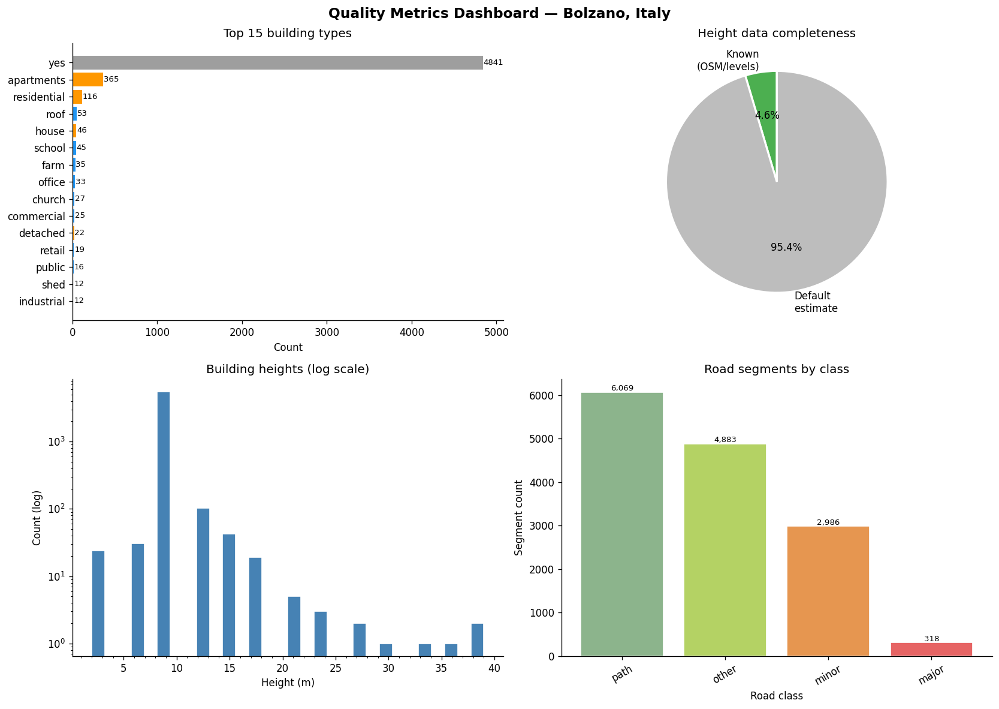

In [16]:
fig, axes = plt.subplots(2, 2, figsize=(14, 10))
fig.suptitle('Quality Metrics Dashboard — Bolzano, Italy', fontsize=14, fontweight='bold')

# ── 1. Top building types (bar) ──
ax = axes[0, 0]
type_counts = gdf_buildings['building_type'].fillna('null').value_counts().head(15)
bar_c = ['#9E9E9E' if t in ('yes','null') else
         '#FF9800' if t in ('apartments','residential','house','detached') else
         '#2196F3' for t in type_counts.index]
ax.barh(type_counts.index[::-1], type_counts.values[::-1], color=bar_c[::-1])
ax.set_xlabel('Count')
ax.set_title('Top 15 building types')
for i, v in enumerate(type_counts.values[::-1]):
    ax.text(v + 5, i, str(v), va='center', fontsize=8)

# ── 2. Height completeness ──
ax = axes[0, 1]
known = meta['stats']['pct_known_height']
wedges, texts, autotexts = ax.pie(
    [known, 100 - known],
    labels=['Known\n(OSM/levels)', 'Default\nestimate'],
    colors=['#4CAF50', '#BDBDBD'],
    autopct='%1.1f%%', startangle=90,
    wedgeprops={'edgecolor': 'white', 'linewidth': 2}
)
ax.set_title('Height data completeness')

# ── 3. Height histogram (log y) ──
ax = axes[1, 0]
h_vals = gdf_buildings['height'].dropna()
ax.hist(h_vals, bins=30, color='steelblue', edgecolor='white', log=True)
ax.set_xlabel('Height (m)')
ax.set_ylabel('Count (log)')
ax.set_title('Building heights (log scale)')
ax.xaxis.set_minor_locator(mticker.AutoMinorLocator())

# ── 4. Road class distribution ──
ax = axes[1, 1]
rc = gdf_roads['road_class'].value_counts()
bar_rc = [road_colours.get(c, '#ccc') for c in rc.index]
ax.bar(rc.index, rc.values, color=bar_rc, edgecolor='white')
ax.set_xlabel('Road class')
ax.set_ylabel('Segment count')
ax.set_title('Road segments by class')
ax.tick_params(axis='x', rotation=30)
for i, v in enumerate(rc.values):
    ax.text(i, v + 30, f'{v:,}', ha='center', fontsize=8)

plt.tight_layout()
plt.show()

In [17]:
# ── Summary table ──────────────────────────────────────────────────────
h_vals = gdf_buildings['height'].dropna()
summary = pd.DataFrame([
    {'Metric': 'Total buildings',         'Value': f"{len(gdf_buildings):,}"},
    {'Metric': 'Total roads',             'Value': f"{len(gdf_roads):,}"},
    {'Metric': 'Height — min',            'Value': f"{h_vals.min():.1f} m"},
    {'Metric': 'Height — mean',           'Value': f"{h_vals.mean():.1f} m"},
    {'Metric': 'Height — median',         'Value': f"{h_vals.median():.1f} m"},
    {'Metric': 'Height — p95',            'Value': f"{h_vals.quantile(0.95):.1f} m"},
    {'Metric': 'Height — max',            'Value': f"{h_vals.max():.1f} m"},
    {'Metric': 'Known height %',          'Value': f"{meta['stats']['pct_known_height']:.1f}%"},
    {'Metric': 'Unique building types',   'Value': str(gdf_buildings['building_type'].nunique())},
    {'Metric': 'Buildings with name',     'Value': f"{gdf_buildings['name'].notna().sum():,}"},
    {'Metric': 'Road classes',            'Value': str(gdf_roads['road_class'].nunique())},
]).set_index('Metric')

summary

,Value
Metric,
Total buildings,"5,794"
Total roads,"14,256"
Height — min,2.0 m
Height — mean,9.1 m
Height — median,9.0 m
Height — p95,9.0 m
Height — max,39.0 m
Known height %,4.6%
Unique building types,49
